In [1]:
import os
import sys

# Set SUMO_HOME if not already set
if 'SUMO_HOME' not in os.environ:
    # Replace with your actual SUMO installation path
    os.environ['SUMO_HOME'] = '/usr/share/sumo'
    
    # Also add SUMO tools to Python path
    tools_dir = os.path.join(os.environ['SUMO_HOME'], 'tools')
    if tools_dir not in sys.path:
        sys.path.append(tools_dir)

# Now import sumolib, etc.
import sumolib

In [5]:
!wget http://download.geofabrik.de/north-america/us/tennessee-latest.osm.pbf && mv tennessee-latest.osm.pbf osmnx_files/

--2025-03-17 01:25:54--  http://download.geofabrik.de/north-america/us/tennessee-latest.osm.pbf
Resolving download.geofabrik.de (download.geofabrik.de)... 65.21.229.87, 95.216.245.233, 95.217.63.98, ...
Connecting to download.geofabrik.de (download.geofabrik.de)|65.21.229.87|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 163920914 (156M) [application/octet-stream]
Saving to: ‘tennessee-latest.osm.pbf’

tennessee-latest.os 100%[===================>] 156.33M  10.4MB/s    in 16s     

2025-03-17 01:26:11 (9.85 MB/s) - ‘tennessee-latest.osm.pbf’ saved [163920914/163920914]

mv: cannot move 'tennessee-latest.osm.pbf' to 'osmnx_files/': Not a directory


In [6]:
import os
import osmnx as ox
import networkx as nx
import re

def preprocess_maxspeed(G):
    for u, v, k, data in G.edges(data=True, keys=True):
        maxspeed = data.get('maxspeed', None)
        if maxspeed:
            if isinstance(maxspeed, list):
                # If maxspeed is a list, extract numeric values and take the maximum
                speeds = [convert_to_kmh(speed) for speed in maxspeed if re.findall(r'\d+', speed)]
                if speeds:
                    data['maxspeed'] = max(speeds)
                else:
                    data['maxspeed'] = None
            else:
                # If maxspeed is a single value, extract the numeric value
                data['maxspeed'] = convert_to_kmh(maxspeed)
        else:
            data['maxspeed'] = None

def convert_to_kmh(speed):
    # Extract numeric value
    value = re.findall(r'\d+', speed)
    if not value:
        return None
    value = float(value[0])
    
    # Check if the speed is in mph and convert to km/h
    if 'mph' in speed.lower():
        return value * 1.60934  # Convert mph to km/h
    else:
        return value  # Assume the speed is already in km/h

In [9]:
ox.settings.all_oneway = False

# Example: create a bounding box or place name
place_name = "Hamilton County, TN, USA"

# Available options for network_type in OSMnx include:
#   'drive'         - for drivable public roads
#   'drive_service' - for drivable roads including service roads
#   'walk'          - for pedestrian networks
#   'bike'          - for cycling networks
#   'all'           - for all ways regardless of use
#   'all_private'   - for all roads including private ones

os.makedirs("osmnx_files", exist_ok=True)

G = ox.graph_from_place(place_name, network_type='drive')
roads = list(G.edges(data=True))
print("Total number of roads:", len(roads))
edges = ox.graph_to_gdfs(G, nodes=False, edges=True)

os.makedirs('osmx_files/', exist_ok=True)
# Convert any columns that contain lists to strings to avoid errors when writing shapefile
for col in edges.columns:
	if edges[col].apply(lambda x: isinstance(x, list)).any():
		edges[col] = edges[col].astype(str)
edges.to_file("osmnx_files/county_edges.shp")

preprocess_maxspeed(G)

ox.save_graphml(G, "osmnx_files/hamilton_county_drive_service.graphml")
ox.io.save_graph_xml(G, filepath="osmnx_files/hamilton_county.osm.xml")

Total number of roads: 44105


/home/rishav/move_od/.venv/lib/python3.10/site-packages/osmnx/io.py:368: UserWarning: For the `save_graph_xml` function to behave properly, the graph must have been created with `ox.settings.all_oneway=True`.
  osm_xml._save_graph_xml(


In [10]:
!netconvert \
  --osm-files osmnx_files/hamilton_county.osm.xml \
  --output-file osmnx_files/hamilton_county.net.xml \
  --remove-edges.isolated \
  --ignore-errors


Success.


In [14]:
#!/usr/bin/env python3
import pandas as pd
import osmnx as ox
from lxml import etree
import networkx as nx
import sumolib
import math

def get_neighboring_nodes(n, x, y, radius):
    neighbors = []
    for node in n.getNodes():
        node_coord = node.getCoord()  # assuming node.getCoord() returns (x, y)
        dx = node_coord[0] - x
        dy = node_coord[1] - y
        d = math.sqrt(dx*dx + dy*dy)
        if d <= radius:
            neighbors.append((node, d))
    return neighbors

def generate_routes_from_od_csv(
    G,
    csv_file="./move_od/lodes_2021-01-04.csv",
    output_trips="osmnx_files/od_routes.trips.xml",
    sumo_net_file="osmnx_files/hamilton_county.net.xml",
    default_mode="car"
):
    # Load SUMO network
    net = sumolib.net.readNet(sumo_net_file)
    
    df = pd.read_csv(csv_file)
    df =df.sort_values('pickup_time_0_secs')

    # Root <routes>
    root = etree.Element("routes")

    # Add the vType element
    etree.SubElement(
        root, "vType",
        id="car",
        accel="2.6",
        decel="4.5",
        sigma="0.5",
        length="5.0",
        minGap="2.5",
        maxSpeed="55.55",
        guiShape="passenger"
    )

    o_lat = list(df["origin_loc_lat"])
    o_lon = list(df["origin_loc_lon"])
    d_lat = list(df["dest_loc_lat"])
    d_lon = list(df["dest_loc_lon"])
    
    if 'pickup_time_0_secs' in df.columns:
        depart_times = list(df['pickup_time_0_secs'])
    else:
        depart_times = [i * 10 for i in range(len(o_lat))]  # Default 10-second spacing

    # Define function to find edge ID from OSM nodes
    def find_edge_id_from_coords(lon, lat, radius=500):  # Increase radius to 500 meters
        """Find SUMO edge ID from coordinates"""
        # Convert to SUMO coordinates
        sumo_x, sumo_y = net.convertLonLat2XY(lon, lat)
        
        # Find nearest SUMO edge with larger radius
        edges = net.getNeighboringEdges(sumo_x, sumo_y, radius)
        if not edges:
            return None
        
        # Sort by distance and get the closest edge
        edges.sort(key=lambda x: x[1])
        return edges[0][0].getID()

    # Create a cache for faster lookup
    edge_cache = {}
    

    def get_edge_id_from_cache(lon, lat):
        key = (lon, lat)
        if key not in edge_cache:
            # Try with increasing search radius
            radii = [100, 500, 1000, 2000]  # Try progressively larger radii
            for radius in radii:
                edge_id = find_edge_id_from_coords(lon, lat, radius)
                if edge_id:
                    edge_cache[key] = edge_id
                    break
            else:
                # If no edge found with any radius, find closest node and use an edge from that node
                sumo_x, sumo_y = net.convertLonLat2XY(lon, lat)
                import math
                
                nodes = get_neighboring_nodes(net, sumo_x, sumo_y, 2000)
                if nodes:
                    nodes.sort(key=lambda x: x[1])  # Sort by distance
                    closest_node = nodes[0][0]
                    # Get any edge connected to this node
                    edges = closest_node.getOutgoing() or closest_node.getIncoming()
                    if edges:
                        edge_cache[key] = edges[0].getID()
                    else:
                        edge_cache[key] = None
                else:
                    edge_cache[key] = None
        return edge_cache[key]

    valid_trips = 0
    for idx, (o_longitude, o_latitude, d_longitude, d_latitude, depart_time) in enumerate(
        zip(o_lon, o_lat, d_lon, d_lat, depart_times)
    ):
        # Get edge IDs for origin and destination using SUMO's functions
        o_edge = get_edge_id_from_cache(o_longitude, o_latitude)
        d_edge = get_edge_id_from_cache(d_longitude, d_latitude)
        
        # Only create trip if both edges exist
        if o_edge is not None and d_edge is not None:
            trip = etree.SubElement(root, "trip")
            trip_id = f"trip_{valid_trips}"
            trip.set("id", trip_id)
            trip.set("type", default_mode)
            trip.set("depart", str(int(depart_time)))
            trip.set("from", o_edge)  # Use SUMO edge ID
            trip.set("to", d_edge)    # Use SUMO edge ID
            valid_trips += 1
        else:
            # For debugging
            if not o_edge:
                print(f"Could not find edge near origin coordinates ({o_longitude}, {o_latitude})")
            if not d_edge:
                print(f"Could not find edge near destination coordinates ({d_longitude}, {d_latitude})")

    # Write to file
    tree = etree.ElementTree(root)
    tree.write(output_trips, pretty_print=True, xml_declaration=True, encoding="utf-8")
    print(f"Generated {valid_trips} valid trips to {output_trips}")
    return output_trips

# Example usage
# G = ox.graph_from_place('Hamilton County, Ohio, USA', network_type='drive')
generate_routes_from_od_csv(
    G, 
    csv_file="./move_od/lodes_2021-01-04.csv",
    output_trips="osmnx_files/od_routes.trips.xml",
    sumo_net_file="osmnx_files/hamilton_county.net.xml"
)

Could not find edge near origin coordinates (-85.39023070870368, 35.12183395460626)
Could not find edge near origin coordinates (-85.39050790591772, 35.12198572746525)
Could not find edge near origin coordinates (-85.39041150007208, 35.12194784999441)
Generated 99997 valid trips to osmnx_files/od_routes.trips.xml


'osmnx_files/od_routes.trips.xml'

In [15]:
from shapely.geometry import Point

# Define the geographic coordinates
from_coords = [(35.03940780388192, -85.26361283659682), (35.04116050000454, -85.25377049999962), (35.04089500003588, -85.25662299997053)]
to_coords = [(35.087353500000006, -85.15578450000001), (35.0756436896599, -85.16301685527785), (35.097761500000004, -85.14475000000002)]

# Convert geographic coordinates to nearest network nodes
from_nodes = [ox.distance.nearest_nodes(G, lon, lat) for lat, lon in from_coords]
to_nodes = [ox.distance.nearest_nodes(G, lon, lat) for lat, lon in to_coords]

# Print the nearest nodes
print("From nodes:", from_nodes)
print("To nodes:", to_nodes)

def get_nearest_edge(node):
    edges = list(G.edges(node, keys=True, data=True))
    if edges:
        osmid = edges[0][3]['osmid']
        if isinstance(osmid, list):
            edge_id = int(osmid[0])
        else:
            edge_id = int(osmid)                
    return edge_id

print("Nearest edges for from_nodes:")
for node in from_nodes:
    print(f"Node: {node}: {get_nearest_edge(node)}")

print("Nearest edges for to_nodes:")
for node in to_nodes:
    print(f"Node: {node}: {get_nearest_edge(node)}")


From nodes: [202703008, 202584355, 1863750036]
To nodes: [6028576490, 6028576806, 1853529780]
Nearest edges for from_nodes:
Node: 202703008: 19509027
Node: 202584355: 19491311
Node: 1863750036: 19500879
Nearest edges for to_nodes:
Node: 6028576490: 639851101
Node: 6028576806: 639851158
Node: 1853529780: 639851124


In [16]:
!duarouter \
  --net-file osmnx_files/hamilton_county.net.xml \
  --route-files osmnx_files/od_routes.trips.xml \
  --output-file osmnx_files/od_routes.rou.xml \
  --ignore-errors \
  --remove-loops

Success.


In [17]:
import subprocess

def run_traffic_assignment(net_file, trips_file, output_file, iterations=5):
    """Run iterative assignment using duarouter"""
    
    # Initial routing
    subprocess.run([
        'duarouter', 
        '-n', net_file,
        '-r', trips_file,
        '-o', f'temp_iter_0.rou.xml',
        '--ignore-errors',
        '--no-warnings'
    ])
    
    # Iterative improvement
    for i in range(1, iterations+1):
        # Run simulation with current routes
        subprocess.run([
            'sumo', 
            '-n', net_file,
            '-r', f'temp_iter_{i-1}.rou.xml',
            '--device.rerouting.adaptation-interval', '10',
            '--device.rerouting.adaptation-weight', '0.5',
            '--vehroute-output', f'temp_vehroutes_{i}.xml',
            '--no-step-log',
            '--no-warnings',
            '--duration-log.disable'
        ])
        
        # Update routes based on simulation
        subprocess.run([
            'duarouter', 
            '-n', net_file,
            '-r', f'temp_vehroutes_{i}.xml',
            '-o', f'temp_iter_{i}.rou.xml',
            '--ignore-errors',
            '--no-warnings'
        ])
    
    # Copy final routes to output
    subprocess.run(['cp', f'temp_iter_{iterations}.rou.xml', output_file])
    
    # Clean up temporary files
    for i in range(iterations+1):
        subprocess.run(['rm', f'temp_iter_{i}.rou.xml'])
        if i > 0:
            subprocess.run(['rm', f'temp_vehroutes_{i}.xml'])

# Run the assignment
run_traffic_assignment(
    'osmnx_files/hamilton_county.net.xml',
    'osmnx_files/od_routes.trips.xml',
    'osmnx_files/od_routes.flows.xml',
    iterations=3
)

Success.up to time step: 36000.00
Success.up to time step: 172845.00e step: 45645.000time step: 93845.00to time step: 117445.00o time step: 140845.00 time step: 164245.00


Error: The vehicle type 'car' for vehicle 'trip_12' is not known.
Quitting (on error).


Success.up to time step: 0.00
Success.up to time step: 0.00


In [18]:
#!/usr/bin/env python3
import subprocess
from lxml import etree

def create_sumo_config(
    net_file="hamilton_county.net.xml",
    route_file="od_routes.rou.xml",
    output_cfg="osmnx_files/mySimulation.sumocfg",
    summary_file="summary.xml",
    tripinfo_file="tripinfo.xml",
    edge_data_file="edgeData.xml",
    end_time=86400
):
    root = etree.Element("configuration")
    
    # Input section
    inp = etree.SubElement(root, "input")
    netf = etree.SubElement(inp, "net-file")
    netf.set("value", net_file)
    rout = etree.SubElement(inp, "route-files")
    rout.set("value", route_file)

    # Time section
    time_el = etree.SubElement(root, "time")
    begin_el = etree.SubElement(time_el, "begin")
    begin_el.set("value", "0")
    end_el = etree.SubElement(time_el, "end")
    end_el.set("value", str(end_time))

    # Processing section
    proc_el = etree.SubElement(root, "processing")
    teleport_el = etree.SubElement(proc_el, "time-to-teleport")
    teleport_el.set("value", "300")
    teleport_disc_el = etree.SubElement(proc_el, "time-to-teleport.disconnected")
    teleport_disc_el.set("value", "1")
    junction_blocker_el = etree.SubElement(proc_el, "ignore-junction-blocker")
    junction_blocker_el.set("value", "60")
    depart_delay_el = etree.SubElement(proc_el, "max-depart-delay")
    depart_delay_el.set("value", "900")

    # Output section
    out_el = etree.SubElement(root, "output")
    summ_el = etree.SubElement(out_el, "summary")
    summ_el.set("value", summary_file)
    trip_el = etree.SubElement(out_el, "tripinfo-output")
    trip_el.set("value", tripinfo_file)
    
    # Add edge data collection - this is the correct way
    edge_data_el = etree.SubElement(out_el, "edgedata-output")
    edge_data_el.set("value", edge_data_file)
    
    # Add additional parameter for collecting specific edge data
    add_el = etree.SubElement(root, "additional-files")
    add_el.set("value", "edge_detector.add.xml")
    
    # Report section
    report_el = etree.SubElement(root, "report")
    verbose_el = etree.SubElement(report_el, "verbose")
    verbose_el.set("value", "false")
    step_log_el = etree.SubElement(report_el, "no-step-log")
    step_log_el.set("value", "true")

    tree = etree.ElementTree(root)
    tree.write(output_cfg, encoding="UTF-8", pretty_print=True, xml_declaration=True)
    
    # Create the additional file for edge data collection
    create_edge_detector_file("osmnx_files/edge_detector.add.xml", edge_data_file, end_time)
    print(f"Created SUMO config: {output_cfg}")

def create_edge_detector_file(filename, output_file, end_time):
    """Create additional file for edge data collection"""
    root = etree.Element("additional")
    
    # Add edge detector for all edges
    detector = etree.SubElement(root, "edgeData")
    detector.set("id", "edgedata")
    detector.set("freq", "900")  # Collect data every 900 seconds
    detector.set("file", output_file)
    detector.set("excludeEmpty", "true")
    detector.set("begin", "0")
    detector.set("end", str(end_time))
    
    tree = etree.ElementTree(root)
    tree.write(filename, encoding="UTF-8", pretty_print=True, xml_declaration=True)
    print(f"Created edge detector file: {filename}")

def run_sumo(sumocfg="osmnx_files/mySimulation.sumocfg"):
    cmd = ["sumo", "-c", sumocfg, "--no-step-log"]
    subprocess.run(cmd, check=True)
    print("SUMO run completed.")

create_sumo_config()
run_sumo()


Created edge detector file: osmnx_files/edge_detector.add.xml
Created SUMO config: osmnx_files/mySimulation.sumocfg


SUMO run completed.


In [19]:
#!/usr/bin/env python3
import subprocess
import xml.etree.ElementTree as ET
import numpy as np

###############################################################################
# B08303 DISTRIBUTION: from your table (each row + total).
###############################################################################
TARGET_B08303 = {
    "lt_5": 3929,      # Less than 5 minutes
    "5_9": 14385,
    "10_14": 25055,
    "15_19": 34072,
    "20_24": 30245,
    "25_29": 13778,
    "30_34": 23160,
    "35_39": 4942,
    "40_44": 4084,
    "45_59": 4902,
    "60_89": 2960,
    "90_plus": 2102
}
TOTAL_TARGET = sum([val for val in TARGET_B08303.values()])

# 1) A function to map the travel-time-in-minutes to the correct B08303 bin
def get_time_bin(tt_min):
    """
    Return the B08303 bin name for a given travel time in minutes.
    Conditions:
      <5 -> "lt_5"
      5-9 -> "5_9"
      10-14 -> "10_14"
      15-19 -> "15_19"
      20-24 -> "20_24"
      25-29 -> "25_29"
      30-34 -> "30_34"
      35-39 -> "35_39"
      40-44 -> "40_44"
      45-59 -> "45_59"
      60-89 -> "60_89"
      >=90 -> "90_plus"
    """
    if tt_min < 5:
        return "lt_5"
    elif 5 <= tt_min <= 9:
        return "5_9"
    elif 10 <= tt_min <= 14:
        return "10_14"
    elif 15 <= tt_min <= 19:
        return "15_19"
    elif 20 <= tt_min <= 24:
        return "20_24"
    elif 25 <= tt_min <= 29:
        return "25_29"
    elif 30 <= tt_min <= 34:
        return "30_34"
    elif 35 <= tt_min <= 39:
        return "35_39"
    elif 40 <= tt_min <= 44:
        return "40_44"
    elif 45 <= tt_min <= 59:
        return "45_59"
    elif 60 <= tt_min <= 89:
        return "60_89"
    else:
        return "90_plus"

# 2) A function to parse tripinfo.xml from SUMO, then bin durations according
#    to the above categories, and compare to your B08303 distribution
def compare_b08303_distribution(tripinfo_file="tripinfo.xml"):
    """
    1) Read tripinfo.xml (which has <tripinfo duration="..."> for each vehicle).
    2) For each trip, convert 'duration' in seconds -> minutes, find bin.
    3) Tally how many vehicles are in each bin.
    4) Compare bin counts to the B08303 target distribution.
    5) Return:
        (mean_error, model_counts, total_vehicles)
       where mean_error is e.g. an average absolute difference in bin fractions.
    """
    # 2.1 parse the XML
    tree = ET.parse(tripinfo_file)
    root = tree.getroot()

    # 2.2 Initialize a dictionary to count how many trips land in each bin
    model_counts = {
        "lt_5": 0,
        "5_9": 0,
        "10_14": 0,
        "15_19": 0,
        "20_24": 0,
        "25_29": 0,
        "30_34": 0,
        "35_39": 0,
        "40_44": 0,
        "45_59": 0,
        "60_89": 0,
        "90_plus": 0
    }
    total_veh = 0

    # 2.3 Iterate each <tripinfo> element
    for tinfo in root.findall("tripinfo"):
        dur_sec = float(tinfo.get("duration", "0"))
        dur_min = dur_sec / 60.0
        bin_name = get_time_bin(dur_min)
        model_counts[bin_name] += 1
        total_veh += 1

    # 2.4 Compute difference from B08303
    # We'll do a simple approach: For each bin:
    #   - get ratio_model = model_counts[bin]/ total_veh
    #   - get ratio_target = TARGET_B08303[bin]/ TOTAL_TARGET
    #   - difference = abs(ratio_model - ratio_target)
    # Then average across bins
    errors = []
    for bin_name, target_count in TARGET_B08303.items():
        model_count = model_counts[bin_name]
        ratio_target = target_count / float(TOTAL_TARGET)
        ratio_model = 0
        if total_veh > 0:
            ratio_model = model_count / float(total_veh)
        diff = abs(ratio_model - ratio_target)
        errors.append(diff)

    mean_error = np.mean(errors)

    return mean_error, model_counts, total_veh

###############################################################################
# 3) A helper to run SUMO once (batch mode) with an existing .sumocfg
###############################################################################
def run_sumo_once(
    sumocfg_file="osmnx_files/mySimulation.sumocfg"
):
    """
    Runs a single SUMO simulation in CLI (batch) mode.
    Requires your sumocfg to reference .net.xml and .rou.xml, etc.
    """
    cmd = ["sumo", "-c", sumocfg_file, "--no-step-log"]
    print(f"[INFO] Running: {' '.join(cmd)}")
    subprocess.run(cmd, check=True)
    print("[INFO] SUMO run completed.")

###############################################################################
# 4) The main calibration loop
###############################################################################
def calibrate_distribution(
    sumocfg_file="osmnx_files/mySimulation.sumocfg",
    tripinfo_file="osmnx_files/tripinfo.xml",
    max_iter=50,
    tolerance=0.01
):
    """
    We do up to max_iter iterations. Each iteration:
    1) run SUMO
    2) parse tripinfo.xml
    3) compare distribution to B08303
    4) if error < tolerance, stop
    5) else 'adjust' your scenario (speeds, OD, etc.) - here it's just a mock

    If you had code to actually revise free-flow speeds or demands, you'd add it
    in the "else" clause below.
    """
    for i in range(1, max_iter+1):
        print(f"\nCALIBRATION ITERATION {i}")
        # (1) run sumo
        run_sumo_once(sumocfg_file=sumocfg_file)

        # (2) compare distribution
        err, model_counts, total_veh = compare_b08303_distribution(
            tripinfo_file=tripinfo_file
        )
        print(f"  B08303 distribution error = {err:.4f}")
        print(f"  Model bin counts = {model_counts}, total trips={total_veh}")

        # (3) check if we pass the threshold
        if err < tolerance:
            print("  B08303 distribution is close enough. Stopping calibration.")
            break
        else:
            # (4) For a real scenario, you might:
            #     - parse hamilton_county.net.xml or route files
            #     - reduce free-flow speeds by some factor if times too short
            #     - or scale demands if times too long
            # We'll just mock that we do something
            print("  Times not matching well -> adjusting speeds/demands (mock). Re-run next iteration...")


calibrate_distribution(
    sumocfg_file="osmnx_files/mySimulation.sumocfg",
    tripinfo_file="osmnx_files/tripinfo.xml",
    max_iter=50,
    tolerance=0.01
)



CALIBRATION ITERATION 1
[INFO] Running: sumo -c osmnx_files/mySimulation.sumocfg --no-step-log


KeyboardInterrupt: 

## Post simulation

In [ ]:
!sumo -c osmnx_files/mySimulation.sumocfg --save-video "osmnx_files/simulation.mp4"

7034.87s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Error: On processing option '--save-video':
 No option with the name 'save-video' exists.
Error: The parameter 'osmnx_files/simulation.mp4' is not allowed in this context.
 Switch or parameter name expected.
Error: Could not parse commandline options.
Quitting (on error).


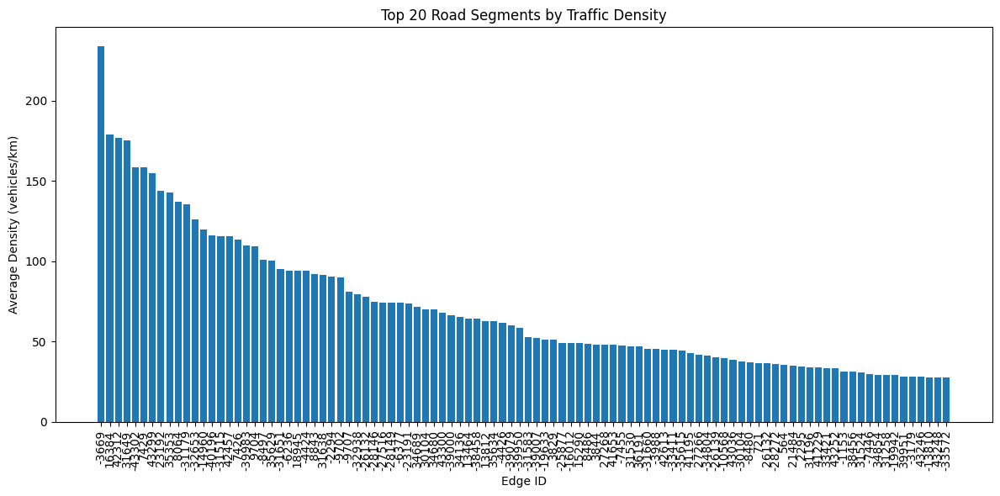

In [94]:
import matplotlib.pyplot as plt
import pandas as pd
import xml.etree.ElementTree as ET

def visualize_traffic_density(edge_data_file):
    # Parse edge data XML
    tree = ET.parse(edge_data_file)
    root = tree.getroot()
    
    # Extract data
    edges = []
    densities = []
    
    for interval in root.findall('interval'):
        for edge in interval.findall('edge'):
            edges.append(edge.get('id'))
            densities.append(float(edge.get('density')))
    
    # Create DataFrame
    df = pd.DataFrame({
        'edge_id': edges,
        'density': densities
    })
    
    # Group by edge_id and take average
    avg_density = df.groupby('edge_id').mean().reset_index()
    
    # Sort by density
    avg_density = avg_density.sort_values('density', ascending=False)
    
    # Plot top 20 edges by density
    plt.figure(figsize=(12, 6))
    plt.bar(avg_density['edge_id'].head(100), avg_density['density'].head(100))
    plt.xticks(rotation=90)
    plt.xlabel('Edge ID')
    plt.ylabel('Average Density (vehicles/km)')
    plt.title('Top 20 Road Segments by Traffic Density')
    plt.tight_layout()
    plt.savefig('traffic_density.png')
    plt.show()

# Generate visualization after simulation
visualize_traffic_density("osmnx_files/edgeData.xml")